# Separable NMF for Blind Music Audio Source Separation

In [1]:
%matplotlib inline
import seaborn
import numpy as np, scipy, matplotlib.pyplot as plt, sklearn, IPython.display as ipd
import librosa, librosa.display
from scipy.io import loadmat, savemat
plt.rcParams['figure.figsize'] = (18, 7)

## Music Audio Source Separation

Audio signals are typically complex mixtures of different sound sources. The sound sources can be several people talking simultaneously in a room, different instruments playing together, or a speaker talking in the foreground with music being played in the background. The decomposition of a complex sound mixture into its constituent components is referred to as source separation. A popular source example of the separation problem is the cocktail party problem, where the objective is to separate the voice of a specific speaker from a mixture of conversations with multiple speakers and background noises.

An audio file is loaded into an array with amplitude scaled to $[-1, 1]$.

In [2]:
n_comps = 7;



p1, sr = librosa.load('audio/extra/piano1.wav'); p1 = p1 - min(p1); p1 = (2/n_comps)*p1/max(p1)-1/n_comps;
p2, sr = librosa.load('audio/extra/piano2.wav'); p2 = p2 - min(p2); p2 = (2/n_comps)*p2/max(p2)-1/n_comps;
p3, sr = librosa.load('audio/extra/piano3.wav'); p3 = p3 - min(p3); p3 = (2/n_comps)*p3/max(p3)-1/n_comps;
c1, sr = librosa.load('audio/extra/clarinet1.wav'); c1 = c1 - min(c1); c1 = (2/n_comps)*c1/max(c1)-1/n_comps;
c2, sr = librosa.load('audio/extra/clarinet2.wav'); c2 = c2 - min(c2); c2 = (2/n_comps)*c2/max(c2)-1/n_comps;
c3, sr = librosa.load('audio/extra/clarinet3.wav'); c3 = c3 - min(c3); c3 = (2/n_comps)*c3/max(c3)-1/n_comps;
stst, sr = librosa.load('audio/extra/strings-staccato.wav'); stst = stst - min(stst); stst = (2/n_comps)*stst/max(stst)-1/n_comps;

comps = np.concatenate((np.transpose(p1), np.transpose(p2), np.transpose(p3), \
                        np.transpose(c1), np.transpose(c2), np.transpose(c3), np.transpose(stst)), axis=0)
comps = comps.reshape(n_comps, len(p1))
x = (p1+p2+p3+c1+c2+c3+stst);

# x, sr = librosa.load('audio/jangle_pop.wav');
# comps = np.matlib.repmat(x/n_comps, n_comps, 1);

print('Dimension of x: ', x.shape, 'Sampling Rate = ', sr)

Dimension of x:  (352800,) Sampling Rate =  22050


Audio Playback:

In [3]:
ipd.display(ipd.Audio(x, rate=sr))

The components:

In [4]:
for i in range(comps.shape[0]):
    ipd.display(ipd.Audio(comps[i, :], rate=sr))
ipd.display(ipd.Audio(x, rate=sr))

### The audio signal `x`

Text(0,0.5,'scaled amplitude')

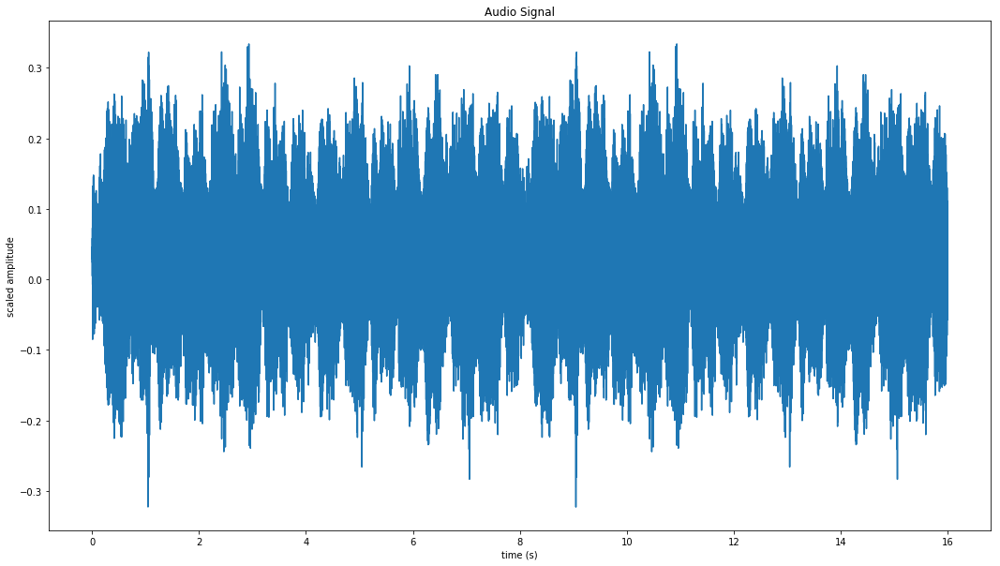

In [5]:
plt.figure(figsize=(18, 10))
plt.plot(np.arange(len(x))/sr, x)
plt.title('Audio Signal')
plt.xlabel('time (s)')
plt.ylabel('scaled amplitude')

### STFT

Musical signals are dynamic, i.e., their statistics change over time. It would be rather meaningless to compute a single Fourier transform over an entire 10-minute song. 

To capture the variation of energy distribution across pitch with time, we compute the Fourier Transform of the original signal with a masking window function that is shifted across time. This results in a Matrix $X_{M+1 \times K+1}$ indexed by $(m, k)$, the time and frequency indices respectively.

This is called the **short-time Fourier transform (STFT)** ([Wikipedia](https://en.wikipedia.org/wiki/Short-time_Fourier_transform) and is defined as follows.

$$ X(m, k) = \sum_{n=0}^{N-1} x(n+mH) w(n) e^{-2\pi jnk/N} $$

Here, $x$ is the original signal, $N$ is the length of the window (support of $w$), and $H$ is the **hop-length**.
Now, if the sampling frequency (or **sampling rate (sr)**) of the original signal is $F_s$ (sampling period = $T_S$ = $\frac{1}{F_S}$), then the physical frequency corresponding to coefficient $k$ is: $$F_{coeff}(k) = \frac{k F_s}{N}$$
The physical time corresponding to coefficient $m$ is: $$T_{coeff}(m) = \frac{m H}{F_s}$$

Now, $$M = \lfloor \frac{T}{H T_s} \rfloor$$ where $T$ is the duration of the signal.

And, $$K = \lfloor \frac{N}{2} \rfloor$$
where $N$ is the window length

So the frequencies represented in the spectogram range in $[0, \frac{F_s}{2}]$.

The STFT of the audio signal $x(n)$

In [6]:
## DEFAULTS
n_fft = 4096
hop_length = n_fft//4

S = librosa.stft(x, n_fft=n_fft, hop_length=hop_length)
print(S.shape)
sr

(2049, 345)


22050

Before Performing NMF, we separate the Spectogram `S` into phase and magnitude components `Smag` and `Spha`, such that `S` $=$ `Smag` $\otimes$ `Spha`. NMF is performed only on `Smag` and `Spha` is retained. Where, $\otimes$ is an element-wise product.

`Smag` is displayed:

In [7]:
Smag, Spha = librosa.magphase(S)

In [8]:
#Thresholded Smag
thresh = np.matlib.repmat( np.mean(Smag, axis=0).reshape(1, Smag.shape[1]) - \
                          1.156*np.std(Smag, axis=0).reshape(1, Smag.shape[1]), \
                          Smag.shape[0], 1)
Sthresh = Smag.copy()
Sthresh[Smag<thresh]=0
np.sqrt(sum(sum((Smag - Sthresh)**2)))/np.sqrt(sum(sum(Smag**2)))

0.0

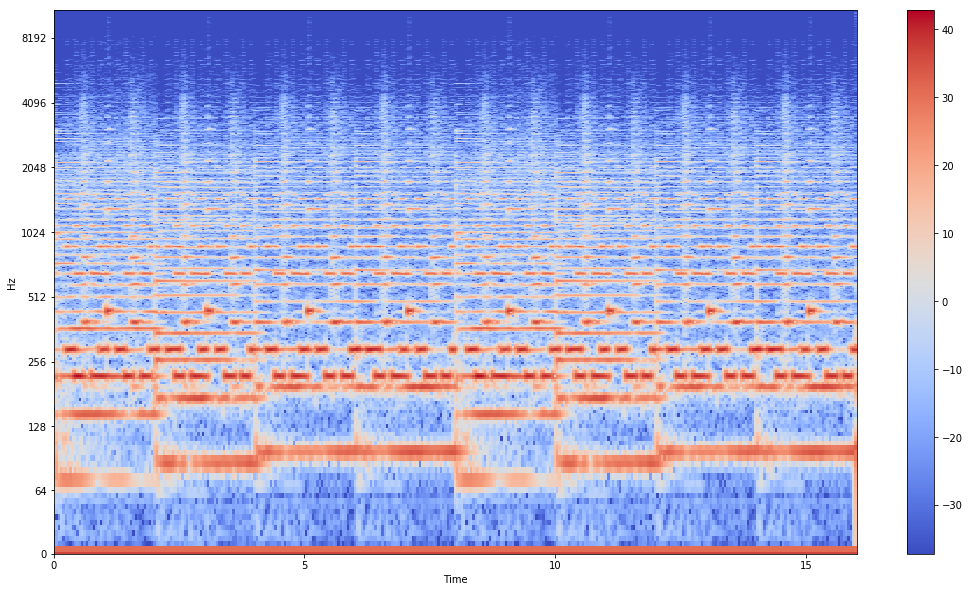

In [9]:
Smag_db = librosa.amplitude_to_db(Smag)
plt.figure(figsize=(18, 10))
librosa.display.specshow(Smag_db, sr=sr, x_axis='time', y_axis='log', hop_length=hop_length)
plt.colorbar()

## Nonnegative Matrix Factorization

Nonnegative Matrix Factorization (NMF) is a linear dimensionality reduction technique to approximate a matrix $M_{m \times n}$ as a product of matrices of rank at most $r$, where $r << min(m, n)$. Given $M_{m \times n}$ and target rank $r$, matrix factorization is the problem of finding $W_{m \times r}$  and $H_{r \times n}$, such that $M = WH$. Expressed another way, this is equivalent to taking weighted linear combinations of the columns of $W$ with the corresponding columns of $H$ as the weights for each column in the data matrix $M$. i.e., $M_{:j} = \sum_{k=1}^{r} W_{:r}H_{kj}$, where $M_{:j}$ denotes the $j^{th}$ column of $M$. When the input matrix is guaranteed to be nonnegative, and the matrices $W$ and $H$ are also required to be nonnegative, the problem becomes nonnegative matrix factorization.

## NMF applied to Music Decomposition

When decomposing a music signal, music-specific properties and additional musical knowledge can be exploited. The number of spectral signatures in music signals is usually fewer than other types of audio and lends itself effectively to NMF techniques. The matrix $M$ used for NMF is obtained by taking the absolute value of the STFT on the audio signal and mapping the intensities of each bin in the resulting spectogram into a component of a spectrum-vector. The spectrum vectors of each time interval are grouped together as column vectors to give $M$. $W$ can be interpreted as the spectral signatures of a few fundamental notes/clusters of notes and $H$ contains the temporal information for when each of these notes is "sounded".

Now, each individual component can be converted back into the audio domain by computing an outer product of its corresponding column (frequency signature) in $W$ and the corresponding row in $H$ (time activations). The original phase is then recombined and an inverse STFT transform (ISFT) is applied. Since it is not true, in general, that every spectogram has a signal whose STFT is the spectogram itself, the ISTFT is obtained by minimising the norm of the error obtained in this process. For more details regarding the mechanism of this optimization, refer [D. W. Griffin and J. S. Lim , "Signal estimation from modified short-time Fourier transform"].

### Existing Techniques

One of the most popular algorithms in use is a multiplicative variant of gradient descent first introduced by Lee and Seung where $W$ and $H$ are alternatively optimized with the other variable kept constant. The algorithm converges to a local optimum but is fast and relatively easy to implement.
$$H_{kj} \leftarrow H_{kj} \frac{(W^{T}M)_{kj}}{(W^{T}WH)_{kj}}$$
$$W_{ik} \leftarrow W_{ik} \frac{(MH^{T})_{ik}}{(WHH^{T})_{ik}}$$

- The advantage with multiplicative rules is that any musically motivated constraint can be hardcoded into the initialization matrix of $W$ and $H$. NMF itself is underspecified and not unique, and the components identified in $W$, called the *Template Matrix* ($H$ is called the *Activation Matrix*) may not correspond neatly to individual pitches/expected groups. Therefore, globally applicable information (e.g., equal temperament tuning to constrain $W$) as well as available information specific to the piece being analyzed (e.g., sheet music to constrain $H$) can be exploited to extract a musically meaningful decomposition.
- The downsides to this method are the fact that to extract meaningful components, one needs additional information to constrain the initializing matrices.

`librosa.decompose.decompose` uses `sklearn.decomposition.NMF` by default as its factorization method. This implements the above multiplicative update method proposed by Lee and Seung to perform our factorization.

In [10]:
M = Smag #Magnitude
n_components = comps.shape[0]
W, H = librosa.decompose.decompose(M, n_components=n_components, sort=True)
print(W.shape)
print(H.shape)

(2049, 7)
(7, 345)


### Component Spectra

The spectra for each component of `W` is displayed (on a log scale)

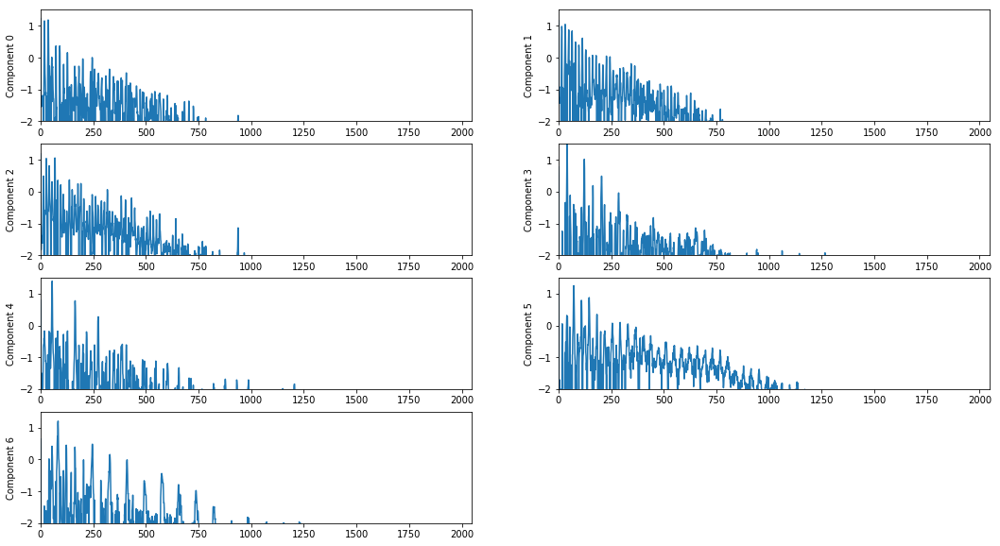

In [11]:
eps = 1e-16
plt.figure(figsize=(18, 10))
logW = np.log10(W + eps) #To avoid divide by zero
for n in range(n_components):
    plt.subplot(np.ceil(n_components/2.0), 2, n+1)
    plt.plot(logW[:,n])
    plt.ylim(-2, logW.max())
    plt.xlim(0, W.shape[0])
    plt.ylabel('Component %d' % n)

### Temporal Activations

The temporal activations of each component, encoded in `H` is displayed:

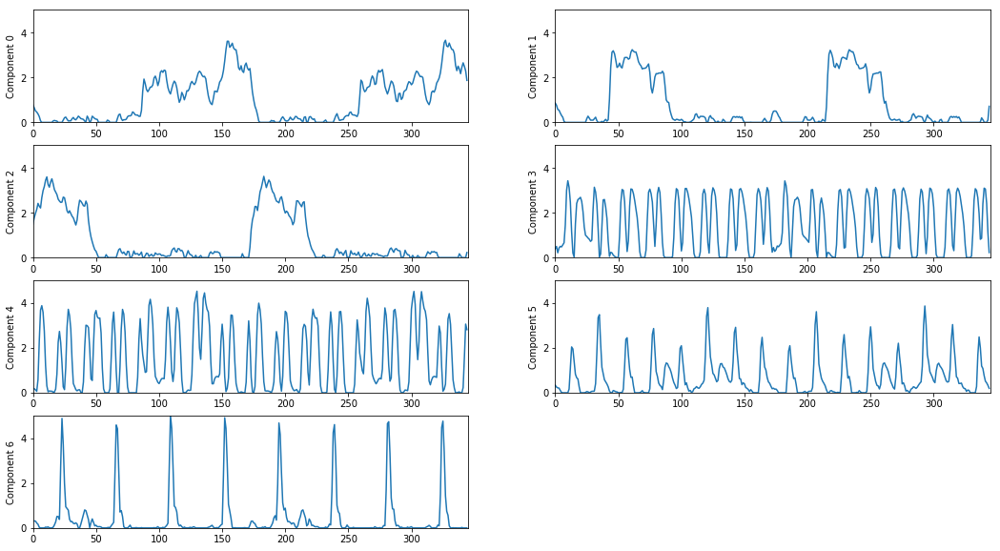

In [12]:
plt.figure(figsize=(18, 10))
for n in range(n_components):
    plt.subplot(np.ceil(n_components/2.0), 2, n+1)
    plt.plot(H[n])
    plt.ylim(0, H.max())
    plt.xlim(0, H.shape[1])
    plt.ylabel('Component %d' % n)

We reconstruct $x$ from the components as well as synthesize the waveforms (which can then be examined by listening) of the extracted components by recombining the phase information in $S_{pha}$

In [13]:
x_recnstr = scipy.zeros(len(x))
comps_nmf = np.zeros(comps.shape);
for n in range(n_components):
    Y = scipy.outer(W[:,n], H[n])*Spha #Recombining phase
    y = librosa.istft(Y, hop_length=hop_length)
    x_recnstr[:len(y)] += y
    comps_nmf[n, :len(y)] = y;
    ipd.display( ipd.Audio(comps_nmf[n, :], rate=sr) )

The reconstructed signal:

In [14]:
ipd.Audio(x_recnstr, rate=sr)

The residual:

In [15]:
residual = x - x_recnstr
residual[0] = 1 # hack to prevent automatic gain scaling
ipd.Audio(residual, rate=sr)


### SNR for the reconstructed signal and components

In [16]:
snr_nmf = np.matlib.repmat([-np.inf], n_comps, 1).ravel()
match_nmf = np.ones(n_comps)
for i in range(n_comps):
#   print (np.sqrt(sum(comps[i, :]**2)))
    for j in range(n_comps):
        pass
        snr = np.sqrt(sum(comps[i, :]**2))/np.sqrt(sum((comps[i, :] - comps_nmf[j, :])**2));
        if snr > snr_nmf[i]:
            snr_nmf[i] = snr
            match_nmf[i] = j

print('Min snr(db) =', 10*np.log10(snr_nmf.min()), '; Mean snr(db) =', 10*np.log10(snr_nmf.mean()),\
     '; Max snr(db) =', 10*np.log10(snr_nmf.max()) )
print('SNR of reconstruction =', 10*np.log10(np.sqrt(sum(x**2))/np.sqrt(sum((x - x_recnstr)**2))))
match_nmf

Min snr(db) = 1.3259560568690425 ; Mean snr(db) = 3.49575799983117 ; Max snr(db) = 5.863447100972344
SNR of reconstruction = 7.76177632887864


array([2., 1., 0., 3., 4., 6., 5.])

## Separable NMF

A matrix $M_{m \times n}$ is said to be $r$-Separable if it permits a nonnegative factorization of the form $M = W[I_{r}, H']\Pi$, where $I_{r}$ is the $r$-Identity matrix and $\Pi$ an $n \times n$ permutation matrix, and $H'$ is $r \times (n-r)$. This is equivalent to $M = M(:, \kappa)H$, where $\kappa$ is an $r$-subset of the columns of $M$ and $H_{r \times n} > 0$. A matrix $M$ is said to be near-separable if it differs from a separable matrix by a noise matrix $\eta$ for $\|\eta\| < \epsilon$, for some choice of norm $\|\cdot\|$and $\epsilon$. When the columns are looked at as $m$-dimensional vectors, this is the same as assuming that the components of the NMF are the edges of the conical hull of all column vectors in the data matrix.

## The Case for Separable NMF for Music Audio Source Separation

By constraining the spectral signatures in the Template matrix to be signatures already found within the spectogram, we can be sure that the signatures identified are legitimate and meaningful patterns that do occur in the piece of music. However, the flip side to this is the fact that the music may not satisfy the separability or the *pure-signal asumption*, i.e., all meaningful components may not occur at isolated points in time by themselves. However, for music with a lot of solo tracks that do satisfy this assumption to a greater degree, this method is promising. However, even for music that is very texturally rich at all points, the decompposition is sure to yield meaningful patterns, if not the notes by themselves and can identify rhythmic and percussive elements in the music.

Also, as a potential fix to the problem, appending the frequency signature samples of the instruments played solo to the spectogram matrix ($M$) would decrease the residual by providing more potential vectors for the basis set while still keeping the final decomposition meaningful.

## SNPA

The Successive Nonnegative Projection Algorithm [Gillis, 2014] is a modified version of the earlier Successive Projection Algorithm (SPA), first proposed by [Ara\`ujo, 2001] which selects a column that maximizes a strongly convex function on the residue and then projects all remaining columns to the orthogonal complement of the selected vector. SNPA, instead, projects the remaining vectors to the convex hull of the columns and the origin to compute the residue. While SPA requires the columns of $W$ to be of full rank, SNPA does not, and SNPA was also shown to be more robust to noise and applicable to a wider class of problems.

### Algorithm:
- **Input** - A near $r$-separable matrix $M = \tilde{M} + \eta$, where $\tilde{M} = WH$, $W = \tilde{M}_{: \kappa}$ for some $r$-subset $\kappa$, and $\|\eta\|_{\infty,1} \leq \epsilon$, a factorization rank $r$,  and a strongly convex function $f$ satisfying certain assumptions (in this study, the L2 norm)
- **Output** A set of indices $J$ such that $M_{:J} \approx W$ upto permutation

Let $R := M$, $J:=\{\}$, $j:=1$

**`while`** $R \neq 0$ and $ j \leq r $ **`do`**:

- $k^{*} \leftarrow \text{arg} \max_{j} f(R_{:j})$

- $ J \leftarrow J \cup \{k^{*}\}$

- $ R_{: i} \leftarrow M_{: i} - M_{: J} H_{: i}^{*}$ for all $i$, where $H_{: i}^{*} = \text{arg} \min_{h \in \Delta} f(M_{: i} M_{: J}h)$

- $j \leftarrow j + 1$

**``end while``**


## Greedy Variants

We consider three variants of the greedy heuristic proposed in XRAY (however, we project the remaining columns to the convex hull of the basis columns and the origin in SNPA and notto the conical hull of the basis columns as in XRAY). The heuristic is based on the greedy strategy of trying to have the maximum possible sum of components of the residues along the new edge (basis column) to be chosen. This is an indicator of the magnitude of the drop in the objective (L2 norm of residue) to be minimized. By projecting every column of the residue matrix along every candidate basis column, we try to find the best candidate column that covers as much of the residue as possible. This greedy stepwise optimal strategy, however, is not guaranteed to output the right columns, even in the noiseless case. For example, if 4 points in 3 dimensions in the planar region $x+y+z=0; x, y, z \geq 0$ are the vertices of an equilateral triangle and its center, then the matrix of column vectors that correspond to the position vectors of these points clearly supports a 3-separable factorization (with the 3 vertex points (column vectors) chosen as the basis columns), as the center can be expressed as a convex combination of the three vertices. However, the best 1-rank factorization (1-point approximation) would consist of just the point in the center of the triangle as part of the $W$ matrix. The greedy heuristic would pick this point (column vector) in the first step and even if the next points it picks are on the vertices, since it does not drop a column (point) once picked, it returns an incorrect solution when the example clearly supports an exact 3-separable factorization.

### Algorithm:
- **Input** - A near $r$-separable matrix $M = \tilde{M} + \eta$, where $\tilde{M} = WH$, $W = \tilde{M}_{: \kappa}$ for some $r$-subset $\kappa$, and $\|\eta\|_{\infty,1} \leq \epsilon$, a factorization rank $r$,  and a strongly convex function $f$ satisfying certain assumptions (in this study, the L2 norm)
- **Output** A set of indices $J$ such that $M_{:J} \approx W$ upto permutation

Let $R := M$, $J:=\{\}$, $j:=1$

**`while`** $R \neq 0$ and $ j \leq r $ **`do`**:

- $k^{*} = arg \max_{j} \dfrac{\|(R^{T} M_{: j})_{+}\|_{2}^{2}}{\|M_{: j}\|_{2}^{2}}$ `//The Greedy Heuristic`

- $ J \leftarrow J \cup \{k^{*}\}$

- $ R_{: i} \leftarrow M_{: i} - M_{: J} H_{: i}^{*}$ for all $i$, where $H_{: i}^{*} = \text{arg} \min_{h \in \Delta} f(M_{: i} M_{: J}h)$

- $j \leftarrow j + 1$

**``end while``**

## Running Greedy Conical Hull Algorithms (SNPA and variants)

Save `Smag` and `n_components` in .mat file

In [17]:
stftMagDict = {'stftMag':M, 'numComps':n_components}
savemat('./stftMag.mat', stftMagDict)

Run `SNPA` and `greedySNPA` (MATLAB scripts)

In [18]:
import os
runMatlab = '/Applications/MATLAB_R2018a.app/bin/matlab -nojvm -nodisplay -nosplash -r "ComputeFactors; exit;"'
os.system(runMatlab) #Return val of zero = success

0

In [19]:
sepNMFDict = loadmat('facts.mat')

J_snpa = sepNMFDict['J_snpa'] - 1
W_snpa = Smag[:, J_snpa.flatten()]
H_snpa = sepNMFDict['H_snpa']

J_greedy = sepNMFDict['J_greedy'] - 1
W_greedy = Smag[:, J_greedy.flatten()]
H_greedy = sepNMFDict['H_greedy']
print(W_snpa.shape, H_snpa.shape)

(2049, 7) (7, 345)


### SNPA Component Spectra

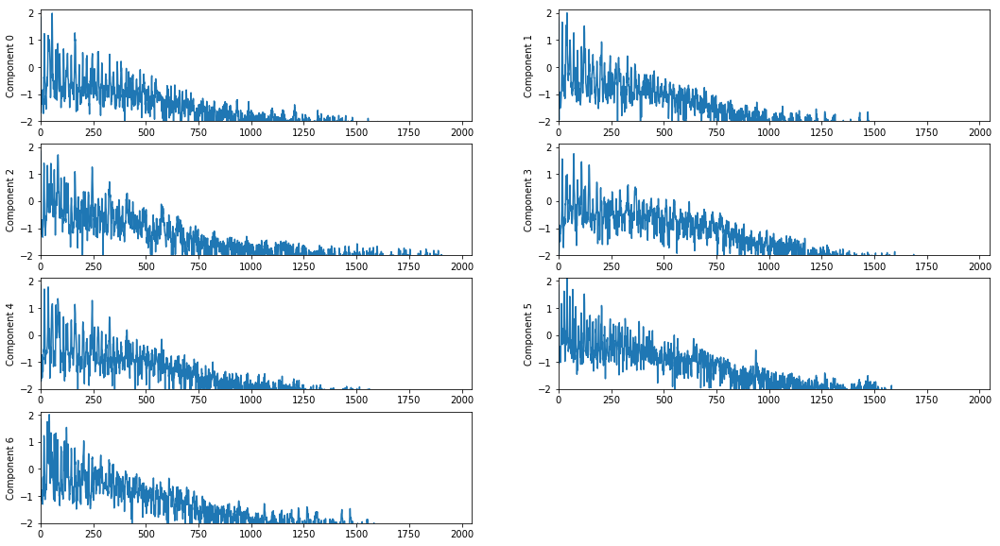

In [20]:
eps = 1e-16
plt.figure(figsize=(18, 10))
logW_snpa = np.log10(W_snpa + eps) #To avoid divide by zero
for n in range(n_components):
    plt.subplot(np.ceil(n_components/2.0), 2, n+1)
    plt.plot(logW_snpa[:,n])
    plt.ylim(-2, logW_snpa.max())
    plt.xlim(0, W_snpa.shape[0])
    plt.ylabel('Component %d' % n)

### SNPA Component Temporal Activations

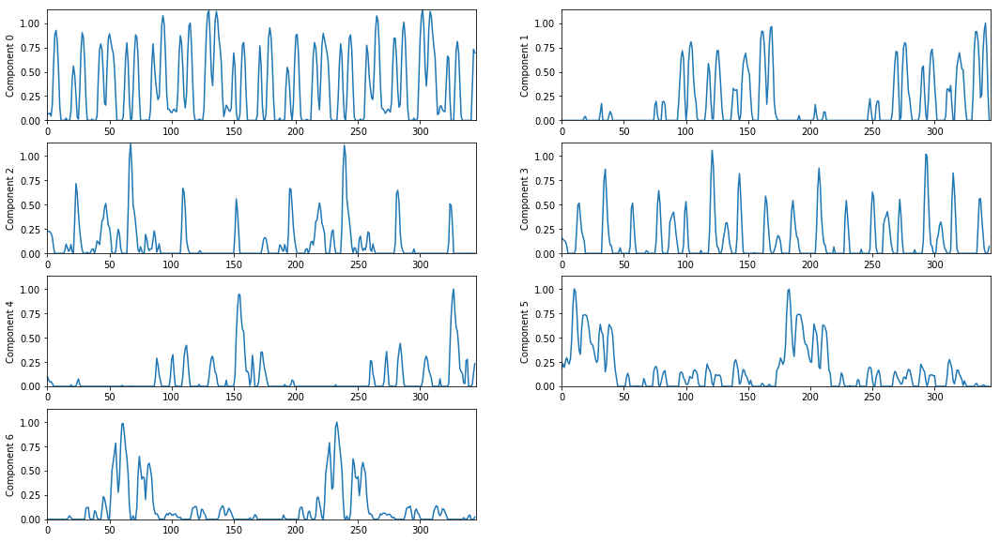

In [21]:
plt.figure(figsize=(18, 10))
for n in range(n_components):
    plt.subplot(np.ceil(n_components/2.0), 2, n+1)
    plt.plot(H_snpa[n])
    plt.ylim(0, H_snpa.max())
    plt.xlim(0, H_snpa.shape[1])
    plt.ylabel('Component %d' % n)

### SNPA Component Audio

In [22]:
x_snpa = scipy.zeros(len(x))
comps_snpa = np.zeros(comps.shape);
for n in range(n_components):
    Y = scipy.outer(W_snpa[:,n], H_snpa[n])*Spha #Recombining phase
    y = librosa.istft(Y, hop_length=hop_length)
    x_snpa[:len(y)] += y
    comps_snpa[n, :len(y)] = y;
    ipd.display( ipd.Audio(comps_snpa[n, :], rate=sr) )

### SNPA Reconstructed Signal and Residual

In [23]:
## Reconstructed Signal
ipd.Audio(x_snpa, rate=sr)

In [24]:
##Residual
residual_snpa = x - x_snpa
residual_snpa[0] = 1 # hack to prevent automatic gain scaling
ipd.Audio(residual_snpa, rate=sr)

### SNPA - SNR for the reconstructed signal and components

In [25]:
snr_snpa = np.matlib.repmat([-np.inf], n_comps, 1).ravel()
match_snpa = np.ones(n_comps)
for i in range(n_comps):
#   print (np.sqrt(sum(comps[i, :]**2)))
    for j in range(n_comps):
        pass
        snr = np.sqrt(sum(comps[i, :]**2))/np.sqrt(sum((comps[i, :] - comps_snpa[j, :])**2));
        if snr > snr_snpa[i]:
            snr_snpa[i] = snr
            match_snpa[i] = j
10*np.log10(snr_snpa)

print('Min snr(db) =', 10*np.log10(snr_snpa.min()), '; Mean snr(db) =', 10*np.log10(snr_snpa.mean()),\
     '; Max snr(db) =', 10*np.log10(snr_snpa.max()) )
print('SNR of reconstruction =', 10*np.log10(np.sqrt(sum(x**2))/np.sqrt(sum((x - x_snpa)**2))))
match_snpa

Min snr(db) = -0.62895686119706 ; Mean snr(db) = 0.9444078293053092 ; Max snr(db) = 2.5920470710495853
SNR of reconstruction = 5.639686931827352


array([4., 2., 4., 1., 0., 2., 3.])

### Greedy Component Spectra

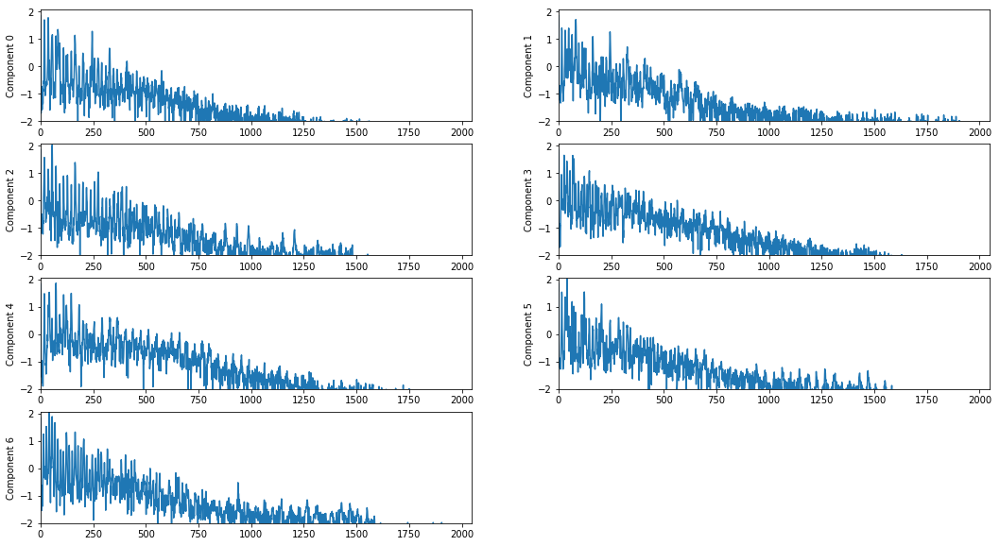

In [26]:
eps = 1e-16
plt.figure(figsize=(18, 10))
logW_greedy = np.log10(W_greedy + eps) #To avoid divide by zero
for n in range(n_components):
    plt.subplot(np.ceil(n_components/2.0), 2, n+1)
    plt.plot(logW_greedy[:,n])
    plt.ylim(-2, logW_greedy.max())
    plt.xlim(0, W_greedy.shape[0])
    plt.ylabel('Component %d' % n)

### Greedy Component Temporal Activations

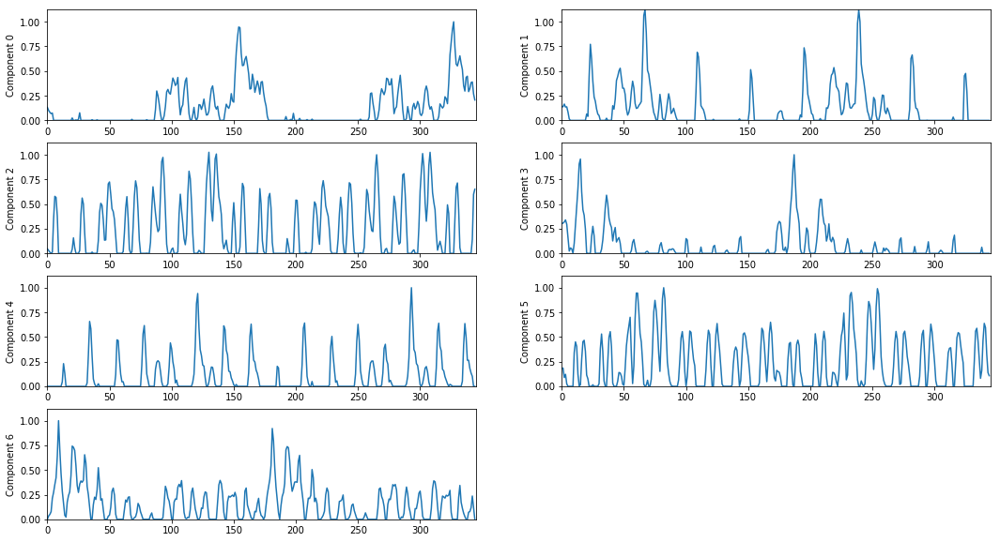

In [27]:
plt.figure(figsize=(18, 10))
for n in range(n_components):
    plt.subplot(np.ceil(n_components/2.0), 2, n+1)
    plt.plot(H_greedy[n])
    plt.ylim(0, H_greedy.max())
    plt.xlim(0, H_greedy.shape[1])
    plt.ylabel('Component %d' % n)

### Greedy Component Audio

In [28]:
x_greedy = scipy.zeros(len(x))
comps_greedy = np.zeros(comps.shape);
for n in range(n_components):
    Y = scipy.outer(W_greedy[:,n], H_greedy[n])*Spha #Recombining phase
    y = librosa.istft(Y, hop_length=hop_length)
    x_greedy[:len(y)] += y
    comps_greedy[n, :len(y)] = y;
    ipd.display( ipd.Audio(comps_greedy[n, :], rate=sr) )
    

### Greedy Reconstructed Signal and Residual

In [29]:
## Reconstructed Signal
ipd.Audio(x_greedy, rate=sr)

In [30]:
##Residual
residual_greedy = x - x_recnstr
residual_greedy[0] = 1 # hack to prevent automatic gain scaling
ipd.Audio(residual_greedy, rate=sr)

### Greedy - SNR for the reconstructed signal and components

In [31]:
snr_greedy = np.matlib.repmat([-np.inf], n_comps, 1).ravel()
match_greedy = np.ones(n_comps)
for i in range(n_comps):
#   print (np.sqrt(sum(comps[i, :]**2)))
    for j in range(n_comps):
        pass
        snr = np.sqrt(sum(comps[i, :]**2))/np.sqrt(sum((comps[i, :] - comps_greedy[j, :])**2));
        if snr > snr_greedy[i]:
            snr_greedy[i] = snr
            match_greedy[i] = j
            
print('Min snr(db) =', 10*np.log10(snr_greedy.min()), '; Mean snr(db) =', 10*np.log10(snr_greedy.mean()),\
     '; Max snr(db) =', 10*np.log10(snr_greedy.max()) )
print('SNR of reconstruction =', 10*np.log10(np.sqrt(sum(x**2))/np.sqrt(sum((x - x_greedy)**2))))
match_greedy

Min snr(db) = 0.39743949703863196 ; Mean snr(db) = 1.2114841988712968 ; Max snr(db) = 2.1829381354223125
SNR of reconstruction = 5.6424270495594975


array([3., 1., 0., 5., 2., 1., 4.])

## Future Work

Despite the signal reconstruction being of very good quality (with the potential of being used as a dimensionality reduction technique), the separation into sources is still poor. The sources are separated by pitch-energy density signatures with a linear mixing model. This does not take into account timbre, an essential aural characteristic that enables us to tell apart different instruments sounding the same pitch. Timbre is often thought to correspond to the energy distribution pattern across harmonics. While NMF uses this feature, this feature is not applied in a pitch-invariant fashion.


### Supervised Source Separation}
There have been quite a few recent developments in guided and data-driven source separation that employ deep learning architectures. More recently, [Chandna et. al] have proposed a low-latency convolutional neural network architecture to for this problem that outputs a time-frequency soft max mask for the STFT (similar to NMF) to reconstruct the sources given a mixed track.